In [1]:
from skyrenderer.utils.common import get_presentation_folder_from_assets

In [2]:
get_presentation_folder_from_assets('/dli/mount/assets', 'gtc03_assets')

# Problem

Machine learning algorithms are getting more and more powerful in all kinds of classification problems,
including image recognition. Increasingly sophisticated models, given enough correctly labeled data,
are able to achieve superb performance and accuracy.
In many cases a class of a problem has an efficient solution already discovered,
but it cannot be applied - the only bottleneck is missing data.

The process of gathering and - especially - labeling data can be extremely expensive and time-consuming.
The images must be manually analyzed by humans, whose labor in such repetitive tasks is not only slow and expensive,
but also less accurate, compared to computers.

In addition, there are cases that require modern equipment for the production of labeled data and highly qualified
specialists to maintain the production process. This case significantly increases the project cost or in many cases,
makes the project realization inaccessible for stakeholders.

# Solution

**What if we could generate automatically the images suited perfectly for the task at hand with the complete
and always correct ground truth built-in?**

We would like to show our attempt to achieve exactly this on the example of football players pose recognition.
The goal is to train the model to accurately recognize the football players and their poses as human keypoints in
3D space on the real-life match footage, like below, having been trained exclusively on artificial, synthetic data.
The images are rendered scenes, that are fully controlled by our renderer,
so all kinds of ground truths can be provided, depending on the model's requirements.

In [3]:
from skyrenderer.example_assistant.markdown_helpers import show_jupyter_picture, show_jupyter_movie

In [4]:
show_jupyter_picture('gtc03_assets/illustrations/football_frame_1.png')

![](gtc03_assets/illustrations/football_frame_1.png)

In [5]:
show_jupyter_picture('gtc03_assets/illustrations/football_frame_2.png')

![](gtc03_assets/illustrations/football_frame_2.png)

In [6]:
show_jupyter_picture('gtc03_assets/illustrations/football_frame_3.png')

![](gtc03_assets/illustrations/football_frame_3.png)

## AGENDA

* Dependencies
* Context Configuration
* SKY ENGINE RENDERER CONFIGURATION
    * The graphic assets
    * Assets configuration
    * Scene Tree Structure
    * Scene
    * Renderer Scenario
    * Renderer Datasource
* TRAINING
* EVALUATION
    * On Synthetic Data
    * On Real Data

In [7]:
from skyrenderer.core.logger_config import configure_logger

In [8]:
logger = configure_logger()

First let's visualize the GPUs available on the machine. Based on this we can select which GPUs will be used
by rendering and learning. By default we use all available devices.

In [9]:
!gpustat

cbe7f17e04e9         Mon Nov  1 11:22:52 2021  450.80.02
[0] Tesla T4         | 48'C,   0 % |   201 / 16127 MB |


In [10]:
import torch

In [11]:
AVAILABLE_GPUS = list(range(torch.cuda.device_count()))

# Sky Engine renderer configuration

### Context configuration

It is required to set the path where the assets (images, meshes, animations etc.) are stored. For convenience,
the example assistant is configured. It will help with visualizations.

In [12]:
from skyrenderer.scene.renderer_context import RendererContext
from skyrenderer.scene.scene import SceneOutput
from skyrenderer.example_assistant.visualization_settings import VisualizationDestination
from skyrenderer.example_assistant.display_config import DisplayConfig
from skyrenderer.example_assistant.example_assistant import ExampleAssistant

In [13]:
root_paths_config = {
    'assets_root': '/dli/mount/assets',
    'cache_root': '/dli/mount/cache'
}
renderer_ctx = RendererContext(root_paths_config, service=False)

2021-11-01 11:22:53,432 | skyrenderer.scene.renderer_context |  INFO: Root paths:
- root path: /home/skyengine/anaconda/lib/python3.6/site-packages/skyrenderer
- assets path: /dli/mount/assets
- config path: /home/skyengine/anaconda/lib/python3.6/site-packages/skyrenderer/config
- optix sources path: /home/skyengine/anaconda/lib/python3.6/site-packages/skyrenderer/optix_sources/sources
- cache path: /dli/mount/cache


In [14]:
display_config = DisplayConfig(visualization_destination=VisualizationDestination.DISPLAY,
                               visualized_outputs=[SceneOutput.BEAUTY],
                               cv_waitkey=0)
example_assistant = ExampleAssistant(context=renderer_ctx, display_config=display_config)

## The graphic assets

In the Sky Engine pipeline the graphic assets, the building blocks for the scene, are prepared by a CG Artist
using third-party software tools. Assets prepared for this scene:

1. Geometries

    The main format used in Sky Engine for carrying information about scene definition: models and their relative
    positions (or position ranges for randomization) is Alembic (.abc).
    Alembic exchange format developed by Sony Pictures Imageworks and Lucasfilm is widely used in the industry
    and is supported by most of the modern CG tools.

    For this scene an artist prepared:

    * Model of a rugby stadium,
    * Animation of a rugby player with keypoints,
    * Scene definition Alembic file - locators specifying positions of all the geometries, lights and camera.
    The player does not have a fixed position, it has a position range instead.

2. Materials

    Sky Engine by default uses a metallic-roughness PBR shader. The input maps for the shader can come from
    files or from the Substance archive (.sbsar). Sky Engine built-in support for Substance allows
    for parameter randomization and texture rendering on the fly in background.

    For this scene an artist prepared:

    * Substance archive for rugby players,
    * Substance archive for parts of the stadium: base, grass, logos, crowd,
    * Files with maps for banners, bumpers and screen.

3. Environmental mapping

    The background for this scene is a simple cloudy sky HDR.

### Geometries

For the Alembic assets prepared according to Sky Engine guidelines,
the whole scene can be loaded and visualized without further configuration.

In [15]:
renderer_ctx.load_abc_scene('stadium')

2021-11-01 11:22:53,455 | skyrenderer.core.asset_manager.asset_manager |  INFO: Syncing git annex...
2021-11-01 11:22:55,525 | skyrenderer.core.asset_manager.asset_manager |  INFO: Syncing git annex done.


In [16]:
renderer_ctx.setup()
logger.info(f'Scene\n{str(renderer_ctx)}')

2021-11-01 11:22:57,704 | main |  INFO: Scene

scene_tree: 
top_node (count: 1)
|-- bumper_GEO_NUL_000 (count: 1)
|   +-- bumper_GEO (count: 1)
|-- bumper_GEO_NUL_001 (count: 1)
|   +-- bumper_GEO_0 (count: 1)
|-- bumper_GEO_NUL_002 (count: 1)
|   +-- bumper_GEO_1 (count: 1)
|-- bumper_GEO_NUL_003 (count: 1)
|   +-- bumper_GEO_2 (count: 1)
|-- light_L01_LIGHT_NUL (count: 1)
|-- light_L02_LIGHT_NUL (count: 1)
|-- light_L03_LIGHT_NUL (count: 1)
|-- light_L04_LIGHT_NUL (count: 1)
|-- player_GEO_NUL (count: 1)
|   +-- player_GEO (count: 1)
|-- rugby_pitch_GEO_NUL_000 (count: 1)
|   +-- rugby_pitch_GEO (count: 1)
|-- rugby_pitch_GEO_NUL_001 (count: 1)
|   +-- rugby_pitch_GEO_0 (count: 1)
|-- screen_GEO_NUL (count: 1)
|   +-- screen_GEO (count: 1)
|-- banners_GEO_NUL (count: 1)
|   +-- banners_GEO (count: 1)
|-- crowd_GEO_NUL (count: 1)
|   +-- crowd_GEO (count: 1)
|-- grass_baners_GEO_NUL (count: 1)
|   +-- grass_baners_GEO (count: 1)
|-- grass_GEO_NUL (count: 1)
|   +-- grass_GEO (count: 1

2021-11-01 11:22:58,797 | skyrenderer.utils.time_measurement |  INFO: Render time: 1.09 seconds


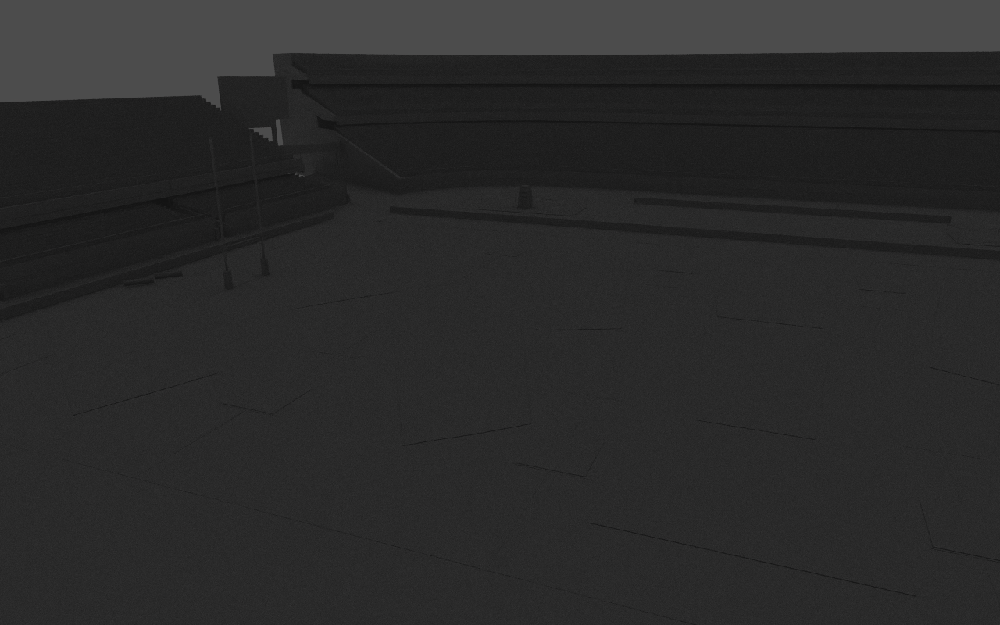

In [17]:
with example_assistant.get_visualizer() as visualizer:
    visualizer(renderer_ctx.render_to_numpy())

### Lights
Lights default value is too small for the large scene, so we need to make them stronger.

In [18]:
from skyrenderer.basic_types.light import PointLight

In [19]:
light_provider = PointLight.create_parameter_provider(renderer_ctx, color=(400, 400, 400))
renderer_ctx.set_light(PointLight(renderer_ctx, 'light_L01_LIGHT_NUL', light_provider))
renderer_ctx.set_light(PointLight(renderer_ctx, 'light_L02_LIGHT_NUL', light_provider))
renderer_ctx.set_light(PointLight(renderer_ctx, 'light_L03_LIGHT_NUL', light_provider))
renderer_ctx.set_light(PointLight(renderer_ctx, 'light_L04_LIGHT_NUL', light_provider))

2021-11-01 11:22:59,137 | skyrenderer.basic_types.light.point_light |  WARNING: Creating light parameter provider in context which is set up - hanging link possible
2021-11-01 11:22:59,137 | skyrenderer.scene.renderer_context |  WARNING: Setting light after setup. Origin refers to last scene tree set up. Lights are stored in dict - change is visible immediately; Wrong parameter provider possible
2021-11-01 11:22:59,138 | skyrenderer.scene.renderer_context |  WARNING: Setting light after setup. Origin refers to last scene tree set up. Lights are stored in dict - change is visible immediately; Wrong parameter provider possible
2021-11-01 11:22:59,138 | skyrenderer.scene.renderer_context |  WARNING: Setting light after setup. Origin refers to last scene tree set up. Lights are stored in dict - change is visible immediately; Wrong parameter provider possible
2021-11-01 11:22:59,139 | skyrenderer.scene.renderer_context |  WARNING: Setting light after setup. Origin refers to last scene tree 

2021-11-01 11:23:00,267 | skyrenderer.utils.time_measurement |  INFO: Render time: 919 ms


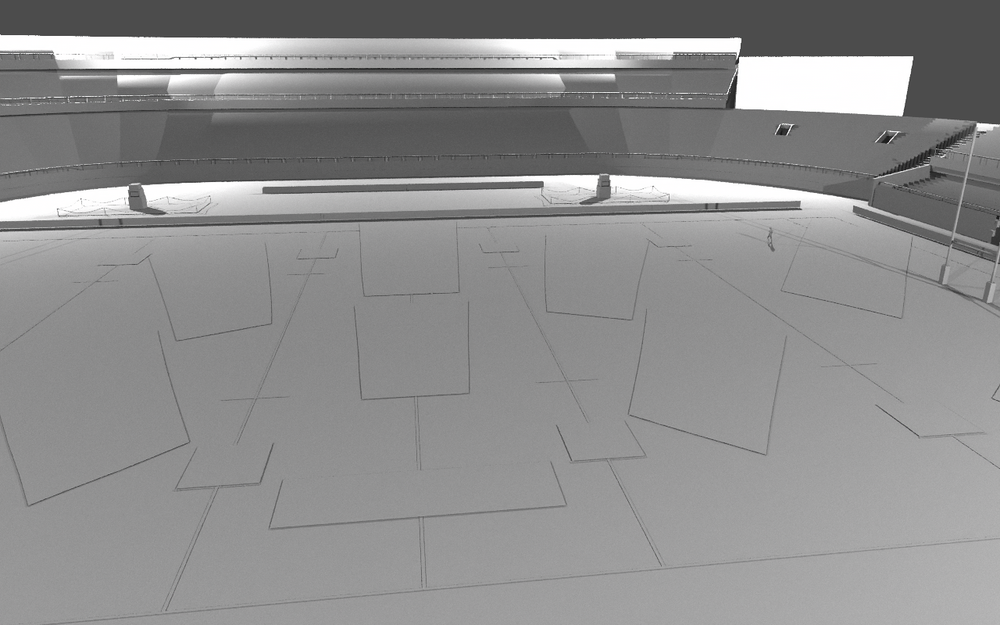

In [20]:
renderer_ctx.setup()
with example_assistant.get_visualizer() as visualizer:
    visualizer(renderer_ctx.render_to_numpy())

### Materials

Each loaded object needs to have a material assigned.

In [21]:
from skyrenderer.scene.scene_layout.layout_elements_definitions import MaterialDefinition
from skyrenderer.basic_types.provider import SubstanceTextureProvider, FileTextureProvider
from skyrenderer.basic_types.procedure import PBRShader

In [22]:
player_textures = SubstanceTextureProvider(renderer_ctx, 'rugby_player')
renderer_ctx.set_material_definition('player_GEO', MaterialDefinition(player_textures))

In [23]:
stadium_base_textures = SubstanceTextureProvider(renderer_ctx, 'concrete')
stadium_base_params = PBRShader.create_parameter_provider(renderer_ctx, tex_scale=50)
renderer_ctx.set_material_definition('stadion_base_GEO',
                                     MaterialDefinition(stadium_base_textures, parameter_set=stadium_base_params))

In [24]:
crowd_textures = SubstanceTextureProvider(renderer_ctx, 'crowd')
crowd_params = PBRShader.create_parameter_provider(renderer_ctx, tex_scale=5)
renderer_ctx.set_material_definition('crowd_GEO', MaterialDefinition(crowd_textures, parameter_set=crowd_params))

In [25]:
grass_textures = SubstanceTextureProvider(renderer_ctx, 'grass')
renderer_ctx.set_material_definition('grass_GEO', MaterialDefinition(grass_textures))

In [26]:
grass_logos_textures = SubstanceTextureProvider(renderer_ctx, 'logos_grass')
renderer_ctx.set_material_definition('grass_baners_GEO', MaterialDefinition(grass_logos_textures))

In [27]:
banners_textures = FileTextureProvider(renderer_ctx, 'banners', 'stadium/banners')
renderer_ctx.set_material_definition('banners_GEO', MaterialDefinition(banners_textures))

In [28]:
screen_texture = FileTextureProvider(renderer_ctx, 'screen', 'stadium/screen')
renderer_ctx.set_material_definition('screen_GEO', MaterialDefinition(screen_texture))

In [29]:
bumpers_texture = FileTextureProvider(renderer_ctx, 'bumpers', 'stadium/bumpers')
renderer_ctx.set_material_definition('bumper_GEO.?.?$', MaterialDefinition(bumpers_texture), use_regex=True)

In [30]:
white_params = PBRShader.create_parameter_provider(renderer_ctx, 'white_params', material_color=(0.8, 0.8, 0.8))
renderer_ctx.set_material_definition('stripes_GEO', MaterialDefinition(parameter_set=white_params))
renderer_ctx.set_material_definition('rugby_pitch_GEO.?.?$', MaterialDefinition(parameter_set=white_params),
                                     use_regex=True)

2021-11-01 11:23:08,836 | skyrenderer.utils.time_measurement |  INFO: Render time: 3.66 seconds


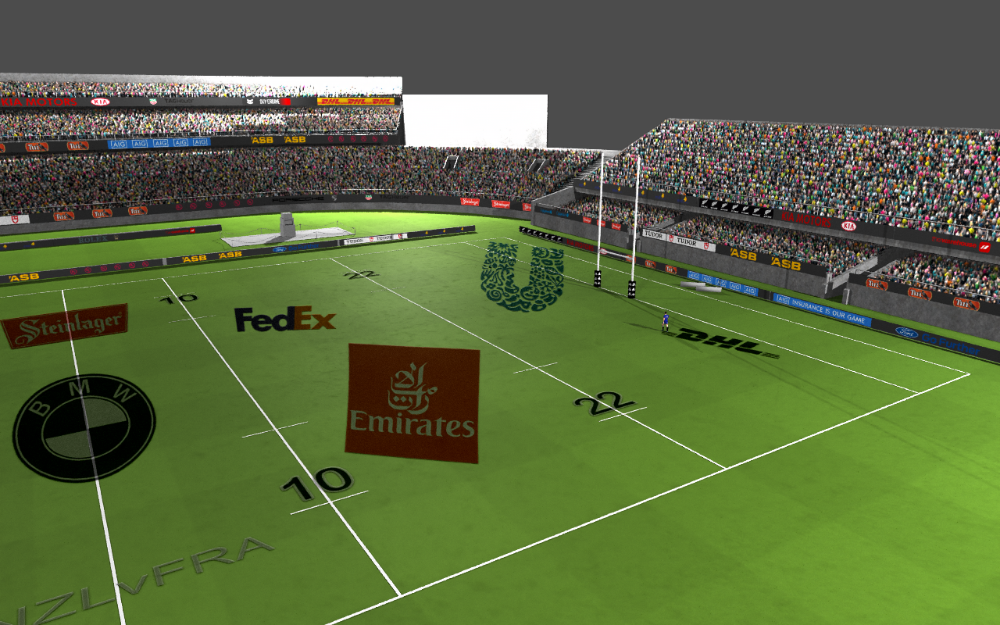

In [31]:
renderer_ctx.setup()
with example_assistant.get_visualizer() as visualizer:
    visualizer(renderer_ctx.render_to_numpy())

Let's replace the gray background with a sky.

In [32]:
from skyrenderer.basic_types.item_component import Background
from skyrenderer.basic_types.procedure import EnvMapMiss
from skyrenderer.basic_types.provider import HdrTextureProvider

In [33]:
renderer_ctx.define_env(Background(renderer_ctx,
                                   EnvMapMiss(renderer_ctx),
                                   HdrTextureProvider(renderer_ctx, 'light_sky')))

2021-11-01 11:23:09,271 | skyrenderer.scene.renderer_context |  WARNING: Setting background definition after setup.


2021-11-01 11:23:13,378 | skyrenderer.utils.time_measurement |  INFO: Render time: 3.89 seconds


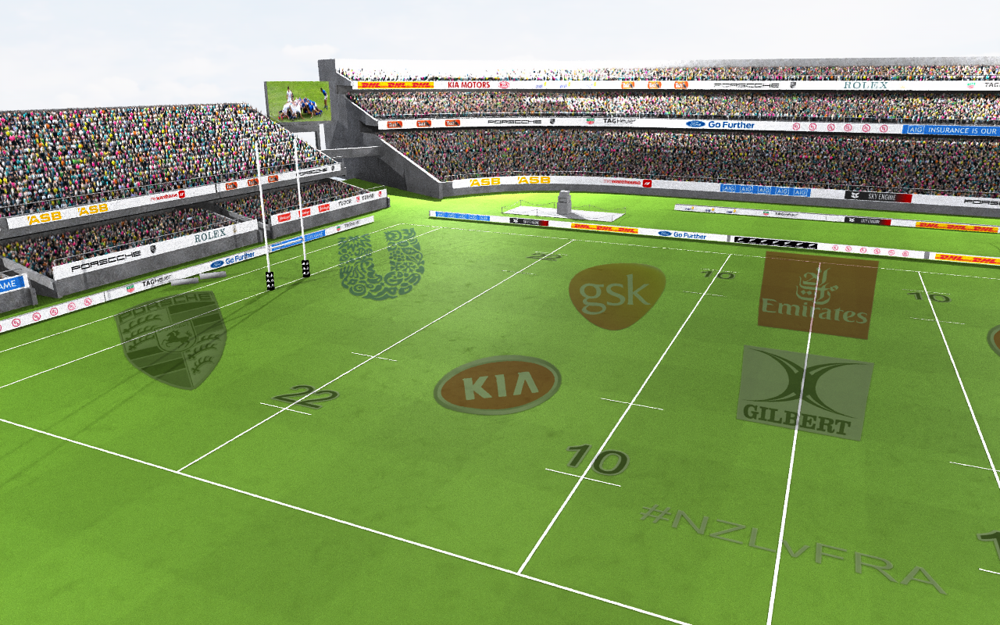

In [34]:
renderer_ctx.setup()
with example_assistant.get_visualizer() as visualizer:
    visualizer(renderer_ctx.render_to_numpy())

### Scene configuration

The Sky Engine renderer provides virtually endless possibilities to shuffle, multiply,
randomize and organize the assets.

From one Alembic animation we are creating two teams of 20 players each.

In [35]:
renderer_ctx.layout().duplicate_subtree(renderer_ctx, 'player_GEO_NUL', suffix='team2')
renderer_ctx.layout().get_node('player_GEO_NUL').n_instances = 20
renderer_ctx.layout().get_node('player_GEO_NUL_team2').n_instances = 20

2021-11-01 11:23:18,448 | skyrenderer.utils.time_measurement |  INFO: Render time: 4.21 seconds


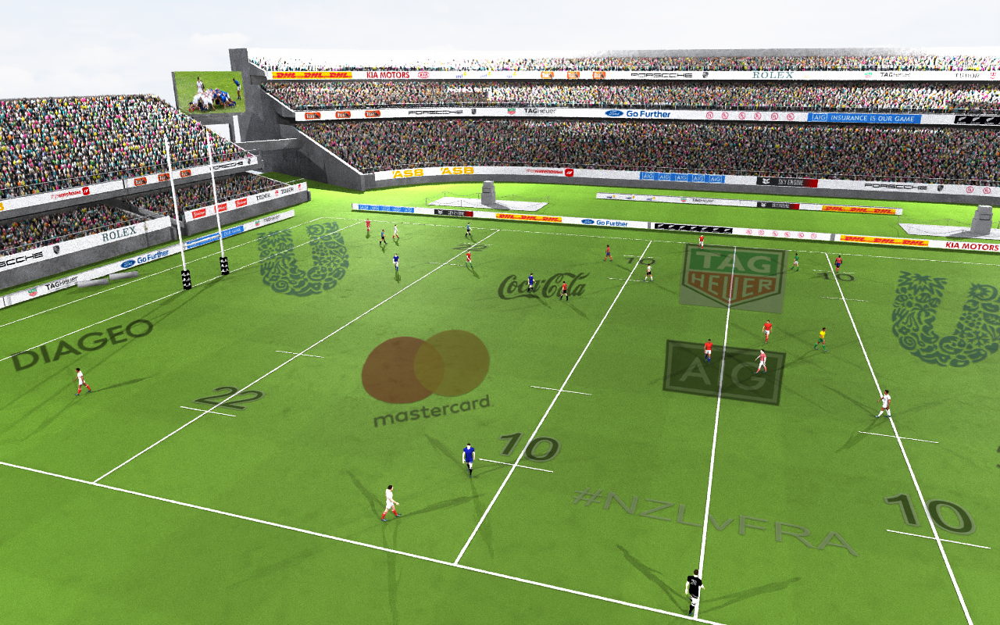

In [36]:
renderer_ctx.setup()
with example_assistant.get_visualizer() as visualizer:
    visualizer(renderer_ctx.render_to_numpy())

By default, all materials are drawn randomly. To create two proper teams we need to ensure that each team
has the same shirt color which is different than the other team's color, while keeping all the other inputs
(hair, skin color, socks color, shirt number etc.) random.

To achieve it, we need to put the the players into separate randomization groups and define
their drawing strategy. The Substance archive input that controls shirt color is called "Colors_select".
It needs to be the same (synchronized) inside the randomization group and different between groups.
All the other inputs are kept randomized by default.

In [37]:
from skyrenderer.randomization.strategy.input_drawing_strategy import SynchronizedInput
from skyrenderer.randomization.strategy.synchronization import Synchronization, SynchronizationDescription
from skyrenderer.randomization.strategy.drawing_strategy import DrawingStrategy

In [38]:
shirt_sync = SynchronizedInput(SynchronizationDescription(
    in_strategy=Synchronization.DISTINCT_EQUAL_GROUPS))
player_material_strategy = DrawingStrategy(renderer_ctx, inputs_strategies={'Colors_select': shirt_sync})
renderer_ctx.instancers['player_GEO'].modify_material_definition(strategy=player_material_strategy)
renderer_ctx.instancers['player_GEO_team2'].modify_material_definition(randomization_group='team2',
                                                                       strategy=player_material_strategy)

2021-11-01 11:23:22,707 | skyrenderer.utils.time_measurement |  INFO: Render time: 3.35 seconds


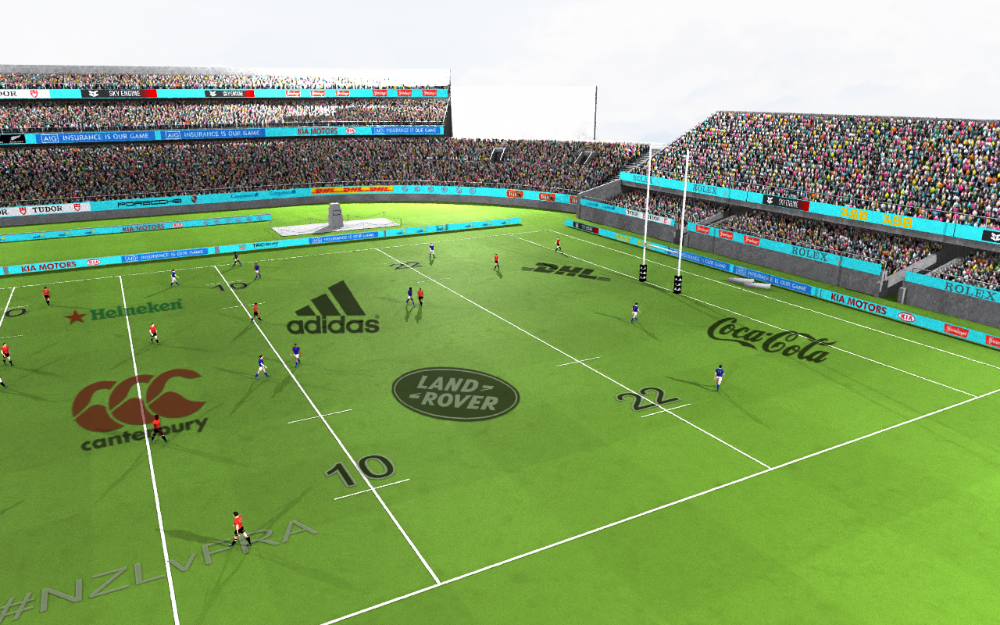

In [39]:
renderer_ctx.setup()
with example_assistant.get_visualizer() as visualizer:
    visualizer(renderer_ctx.render_to_numpy())

If you looked closer on the picture above, you might notice that each player is in the exact same pose.
By default, Sky Engine plays animations from Alembic files frame by frame, so we need to randomize this parameter.

In [40]:
from skyrenderer.randomization.strategy.input_drawing_strategy import UniformRandomInput

In [41]:
player_geometry_strategy = DrawingStrategy(renderer_ctx, frame_numbers_strategy=UniformRandomInput())
renderer_ctx.instancers['player_GEO'].modify_geometry_definition(strategy=player_geometry_strategy)
renderer_ctx.instancers['player_GEO_team2'].modify_geometry_definition(strategy=player_geometry_strategy)

2021-11-01 11:23:27,683 | skyrenderer.utils.time_measurement |  INFO: Render time: 4.11 seconds


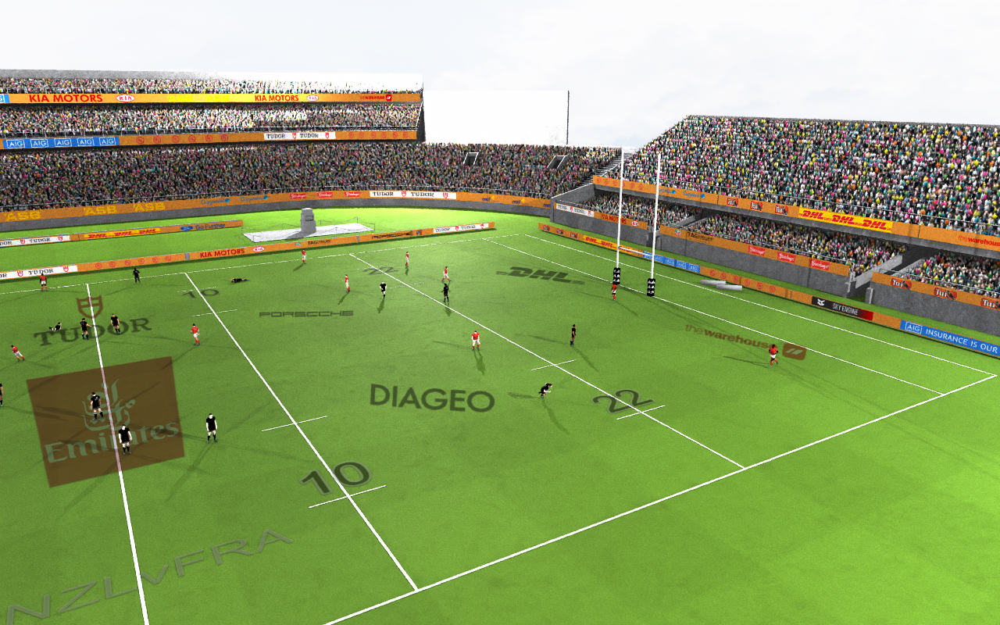

In [42]:
renderer_ctx.setup()
with example_assistant.get_visualizer() as visualizer:
    visualizer(renderer_ctx.render_to_numpy())

During the rugby match, players are not distributed roughly uniformly - they tend to gather
in a group closer together. To make the scene look more natural, we can change the way the players' positions
are drawn. Instead of drawing them uniformly, we can use random Gaussian random distribution.
It is double-random, because first $\mu$ and $\sigma$ are drawn, and then the positions for players
are drawn also randomly with these parameters.

In [43]:
from skyrenderer.randomization.strategy.input_drawing_strategy import RandomGaussianRandomInput

In [44]:
gauss_strategy = DrawingStrategy(renderer_ctx,
                                 default_input_strategy=RandomGaussianRandomInput(sigma_relative_limits=(0.1, 0.4)))
renderer_ctx.layout().get_node('player_GEO_NUL').modify_locus_definition(strategy=gauss_strategy)
renderer_ctx.layout().get_node('player_GEO_NUL_team2').modify_locus_definition(strategy=gauss_strategy)
renderer_ctx.setup()

2021-11-01 11:23:34,086 | skyrenderer.utils.time_measurement |  INFO: Render time: 5.51 seconds


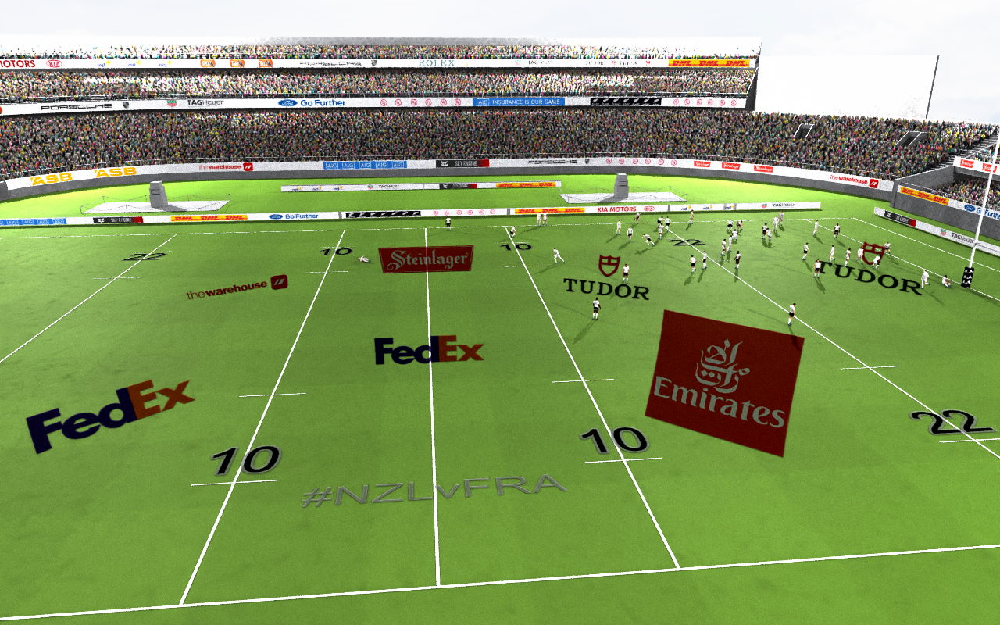

In [45]:
with example_assistant.get_visualizer() as visualizer:
    visualizer(renderer_ctx.render_to_numpy())

2021-11-01 11:23:37,793 | skyrenderer.utils.time_measurement |  INFO: Render time: 3.36 seconds


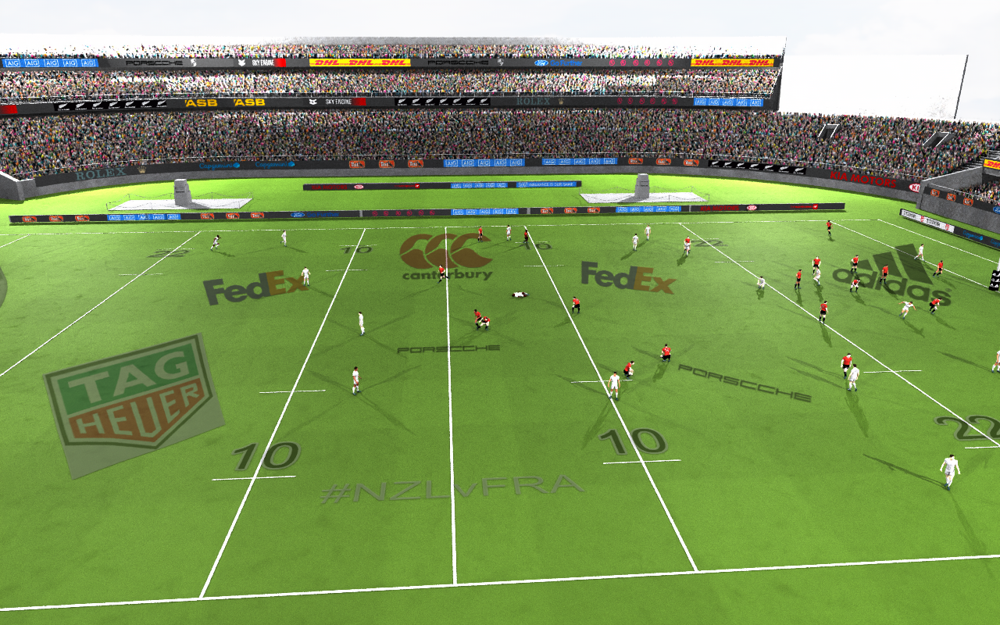

In [46]:
with example_assistant.get_visualizer() as visualizer:
    visualizer(renderer_ctx.render_to_numpy())

2021-11-01 11:23:41,410 | skyrenderer.utils.time_measurement |  INFO: Render time: 3.25 seconds


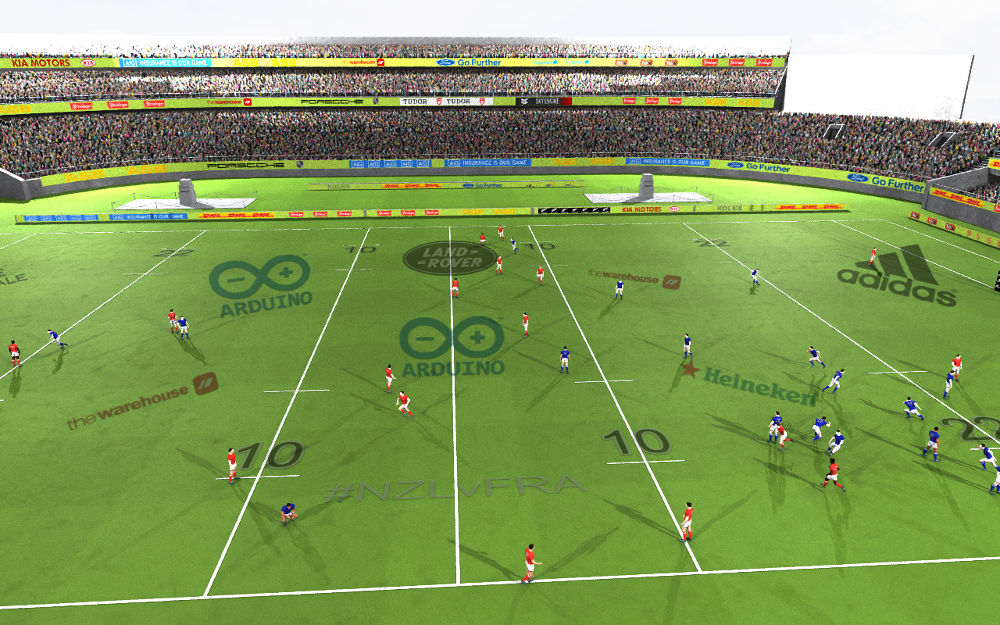

In [47]:
with example_assistant.get_visualizer() as visualizer:
    visualizer(renderer_ctx.render_to_numpy())

2021-11-01 11:23:44,935 | skyrenderer.utils.time_measurement |  INFO: Render time: 3.18 seconds


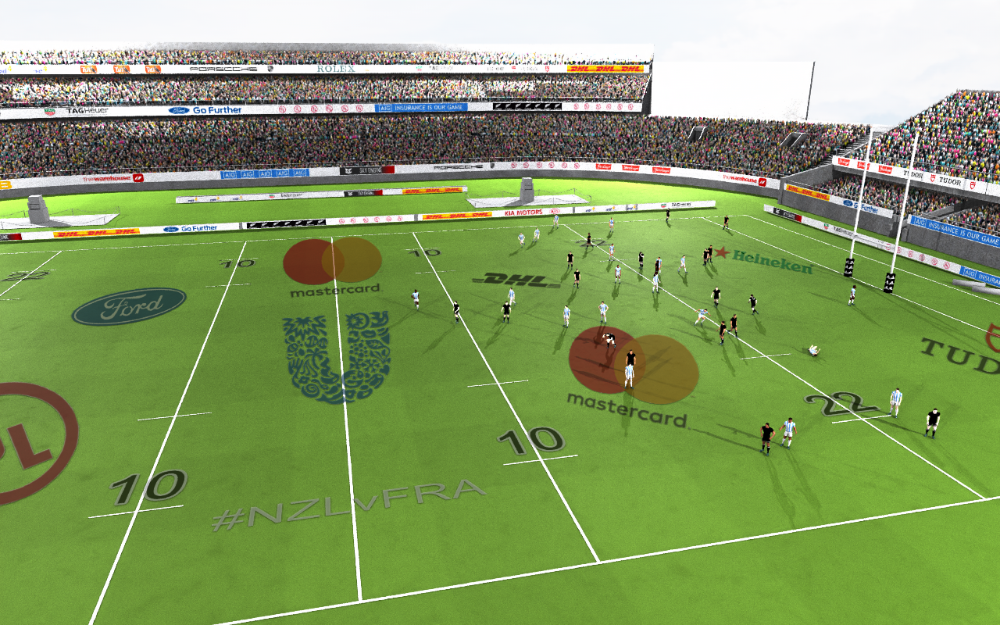

In [48]:
with example_assistant.get_visualizer() as visualizer:
    visualizer(renderer_ctx.render_to_numpy())

2021-11-01 11:23:48,387 | skyrenderer.utils.time_measurement |  INFO: Render time: 3.12 seconds


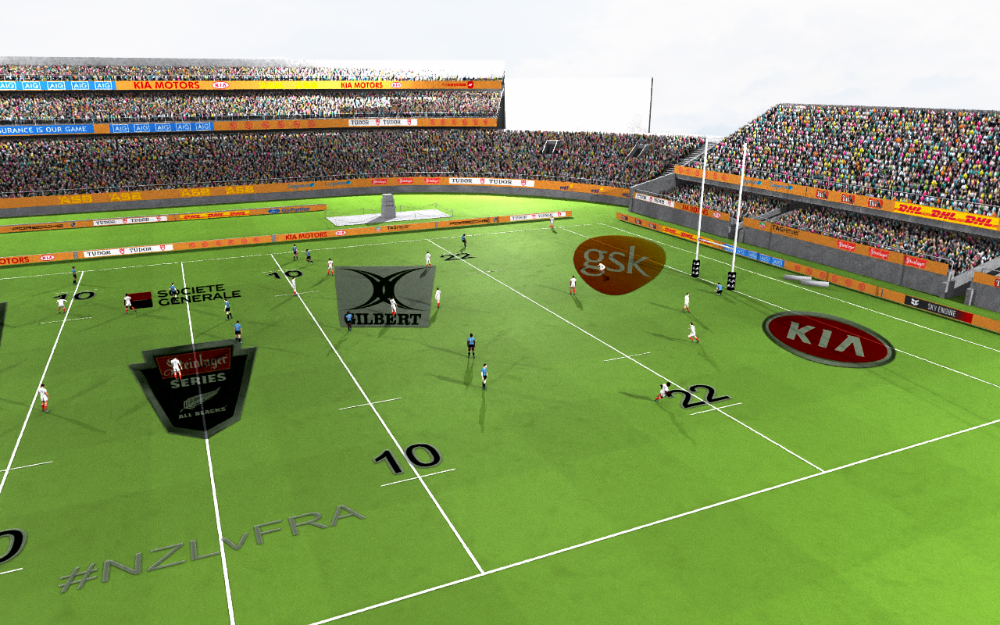

In [49]:
with example_assistant.get_visualizer() as visualizer:
    visualizer(renderer_ctx.render_to_numpy())

This concludes configuration of materials, geometries and their positions.

### Lights

The artist defined light positions in the Alembic scene definition. By default they have a constant intensity.
We will randomize them.

In [50]:
from skyrenderer.basic_types.provider.provider_inputs import HSVColorInput
from skyrenderer.basic_types.light import PointLight

In [51]:
white_light_provider = PointLight.create_parameter_provider(renderer_ctx,
                                                            color=HSVColorInput(hue_range=(0, 0),
                                                                                saturation_range=(0, 0),
                                                                                value_range=(200, 400)))
renderer_ctx.set_light(PointLight(renderer_ctx, 'light_L01_LIGHT_NUL', white_light_provider))
renderer_ctx.set_light(PointLight(renderer_ctx, 'light_L02_LIGHT_NUL', white_light_provider))
renderer_ctx.set_light(PointLight(renderer_ctx, 'light_L03_LIGHT_NUL', white_light_provider))
renderer_ctx.set_light(PointLight(renderer_ctx, 'light_L04_LIGHT_NUL', white_light_provider))

2021-11-01 11:23:48,726 | skyrenderer.basic_types.light.point_light |  WARNING: Creating light parameter provider in context which is set up - hanging link possible
2021-11-01 11:23:48,727 | skyrenderer.scene.renderer_context |  WARNING: Setting light after setup. Origin refers to last scene tree set up. Lights are stored in dict - change is visible immediately; Wrong parameter provider possible
2021-11-01 11:23:48,727 | skyrenderer.scene.renderer_context |  WARNING: Setting light after setup. Origin refers to last scene tree set up. Lights are stored in dict - change is visible immediately; Wrong parameter provider possible
2021-11-01 11:23:48,728 | skyrenderer.scene.renderer_context |  WARNING: Setting light after setup. Origin refers to last scene tree set up. Lights are stored in dict - change is visible immediately; Wrong parameter provider possible
2021-11-01 11:23:48,728 | skyrenderer.scene.renderer_context |  WARNING: Setting light after setup. Origin refers to last scene tree 

### Camera

Now we must improve the camera and its filters.
The rendering process in Sky Engine is defined by a chain of render steps.
The output of a step is an input of the next one. We define four render steps:
* PinholeRenderStep - simple pinhole camera with randomized horizontal field of view (hfov, in degrees),
which simulates random zoom,
* Denoiser - AI-Accelerated Optix Denoiser,
* Tonemapper - Optix tonemapper with randomized parameters - gamma and exposure,
* GaussianBlurPostprocess - the train images should not be perfect. Images with different degree of blurring
help the model to generalize better. Here we're using random Gaussian blur.

Additionally, we're reducing the output size to match the deep learning model required input size.

In [52]:
from skyrenderer.render_chain import RenderChain, PinholeRenderStep, Denoiser, Tonemapper, GaussianBlurPostprocess
from skyrenderer.basic_types.provider.provider_inputs import IntInput, FloatInput

In [53]:
HEIGHT = 768
WIDTH = 1024

In [54]:
pinhole_params = PinholeRenderStep.create_hfov_parameter_provider(renderer_ctx,
                                                                  hfov=IntInput(min_value=15, max_value=35))
camera_step = PinholeRenderStep(renderer_ctx, origin_name='camera_CAM_NUL', target_name='camera_target_NUL',
                                parameter_provider=pinhole_params)

In [55]:
denoiser = Denoiser(renderer_ctx)

In [56]:
tonemapper_params = Tonemapper.create_parameter_provider(renderer_ctx, gamma=FloatInput(min_value=2, max_value=5),
                                                         exposure=FloatInput(min_value=0.7, max_value=1))
tonemapper = Tonemapper(renderer_ctx, parameter_provider=tonemapper_params)

In [57]:
gauss_blur_params = GaussianBlurPostprocess.create_random_parameter_provider(renderer_ctx, max_kernel_radius=7,
                                                                             max_sigma_x=2, max_sigma_y=0.7)
gauss_blur = GaussianBlurPostprocess(renderer_ctx, parameter_provider=gauss_blur_params)

In [58]:
renderer_ctx.define_render_chain(RenderChain([camera_step, denoiser, tonemapper, gauss_blur],
                                             width=WIDTH,
                                             height=HEIGHT))

In [59]:
renderer_ctx.setup()

2021-11-01 11:23:51,778 | skyrenderer.utils.time_measurement |  INFO: Render time: 2.44 seconds


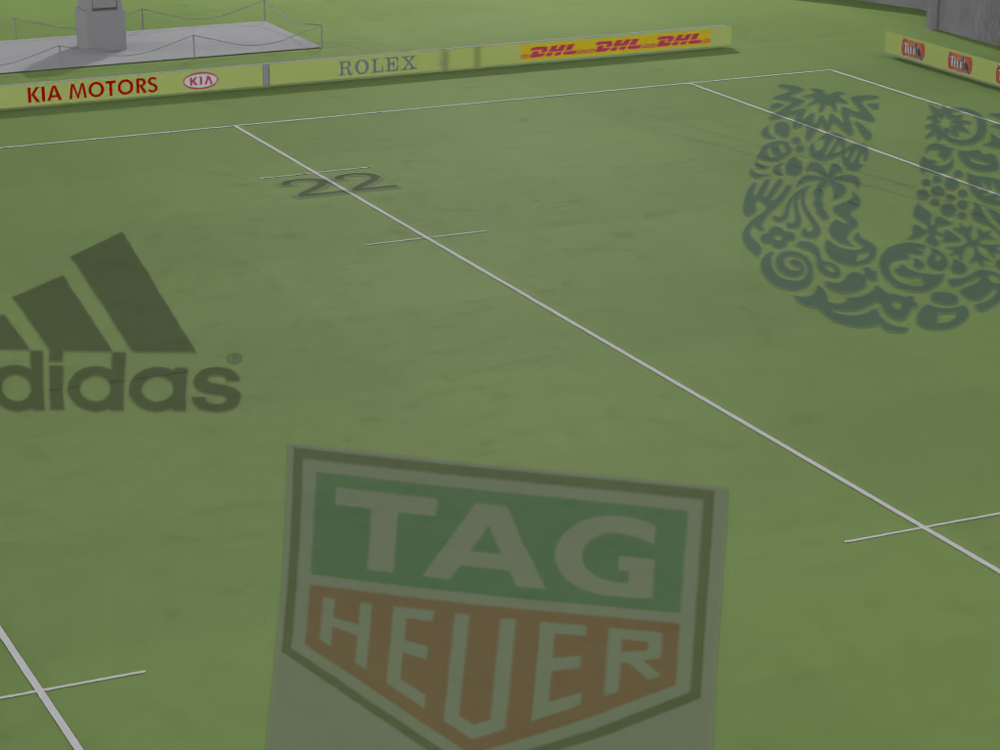

In [60]:
with example_assistant.get_visualizer() as visualizer:
    visualizer(renderer_ctx.render_to_numpy())

2021-11-01 11:23:53,477 | skyrenderer.utils.time_measurement |  INFO: Render time: 1.48 seconds


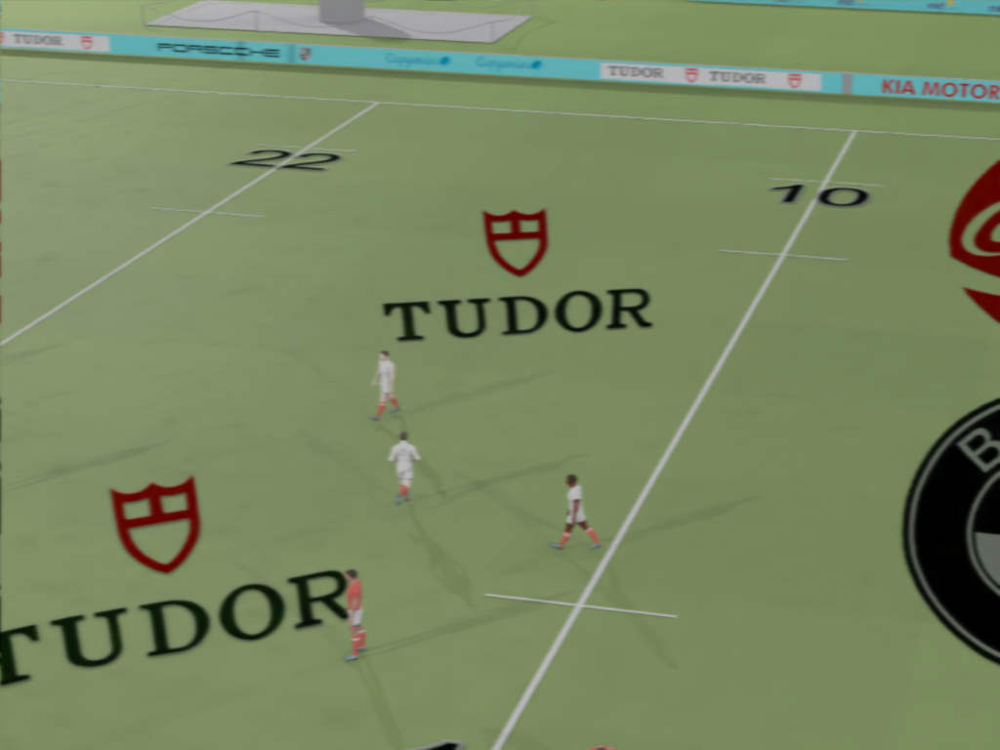

In [61]:
with example_assistant.get_visualizer() as visualizer:
    visualizer(renderer_ctx.render_to_numpy())

2021-11-01 11:23:56,358 | skyrenderer.utils.time_measurement |  INFO: Render time: 2.74 seconds


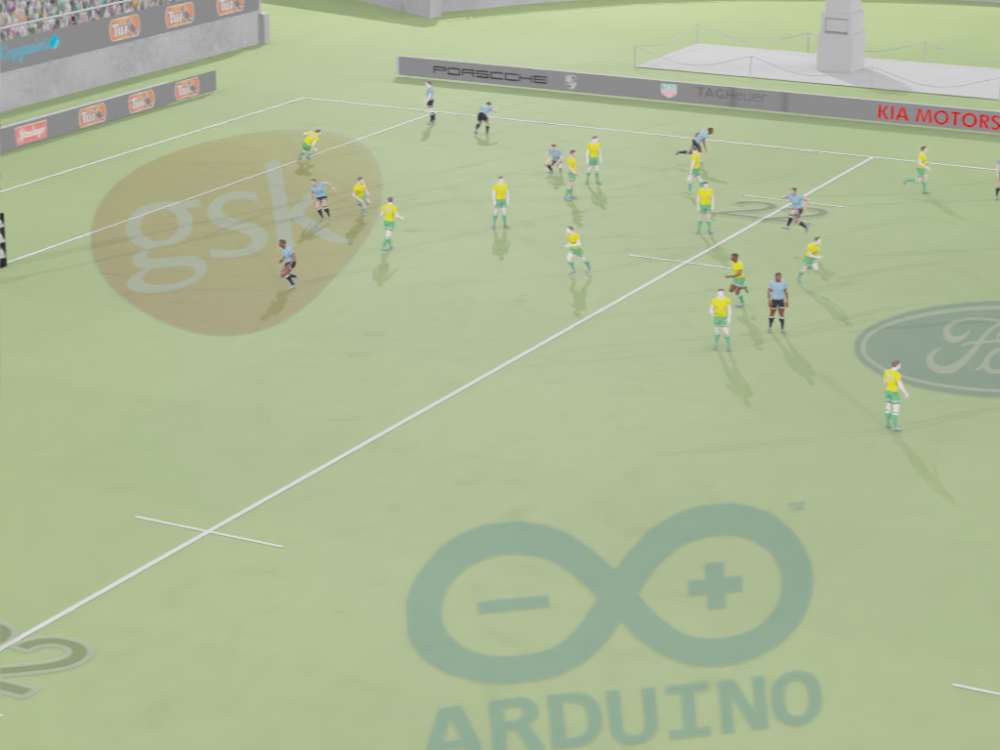

In [62]:
with example_assistant.get_visualizer() as visualizer:
    visualizer(renderer_ctx.render_to_numpy())

2021-11-01 11:23:58,067 | skyrenderer.utils.time_measurement |  INFO: Render time: 1.53 seconds


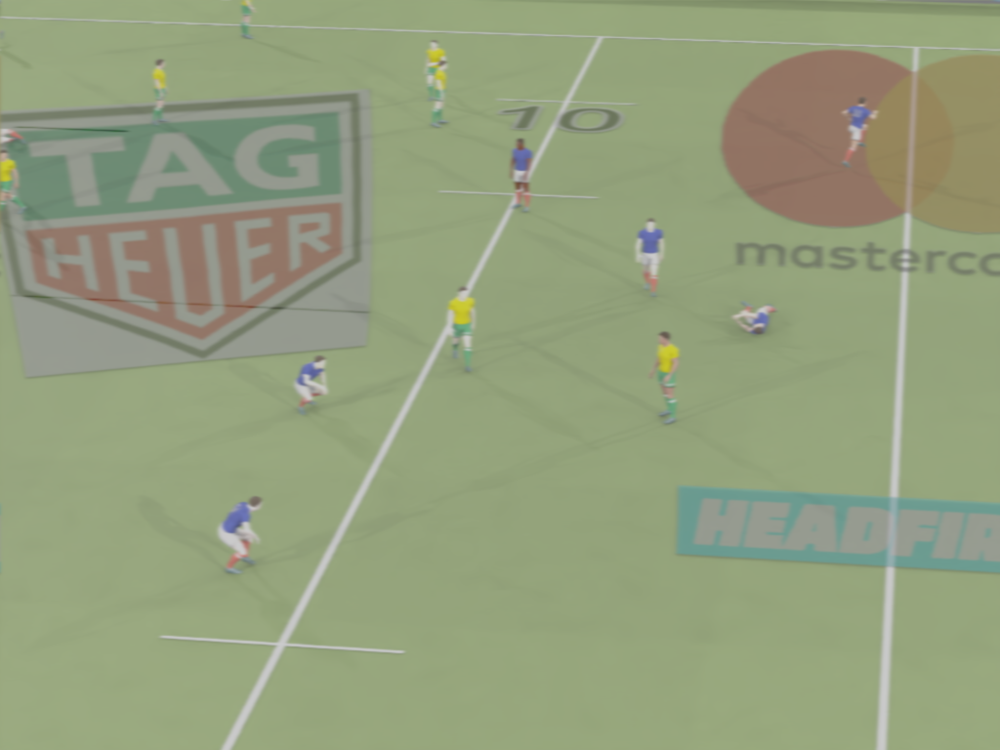

In [63]:
with example_assistant.get_visualizer() as visualizer:
    visualizer(renderer_ctx.render_to_numpy())

2021-11-01 11:23:59,761 | skyrenderer.utils.time_measurement |  INFO: Render time: 1.57 seconds


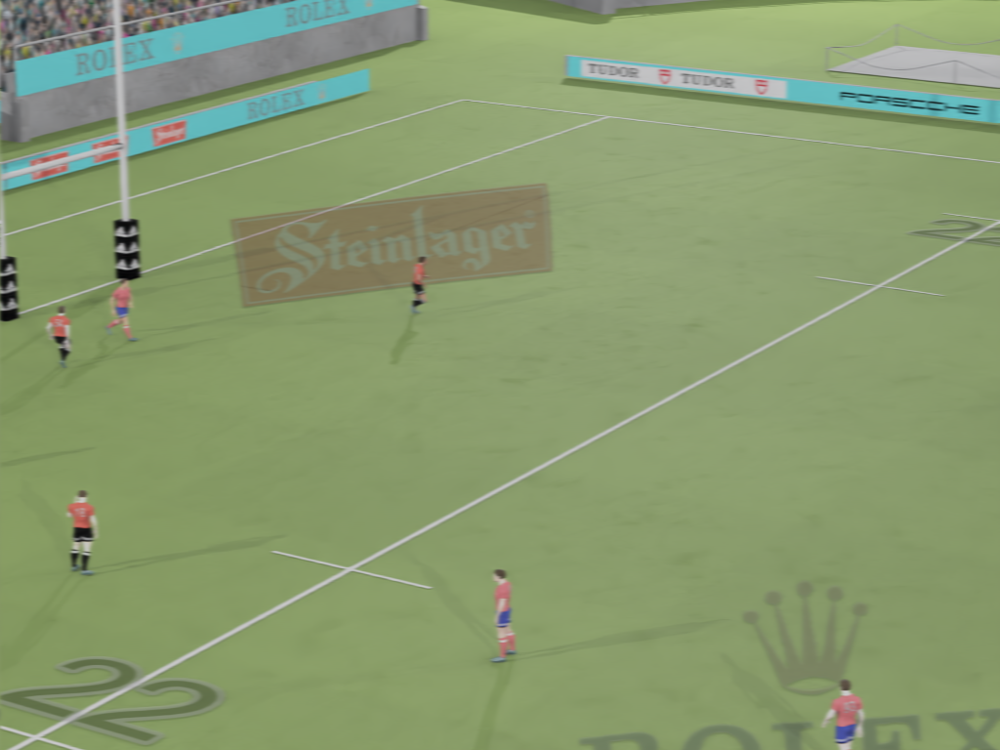

In [64]:
with example_assistant.get_visualizer() as visualizer:
    visualizer(renderer_ctx.render_to_numpy())

### Scene semantics

Last but not least, we must provide ground truth - information about scene semantics.
This setup is designed for player detection with keypoints, so we must assign the semantic class only to players.

As mentioned before, the keypoints are already present in the player animation. Sky Engine by default calculates
all the information about keypoints, if it receives them in the input assets, we just need to visualize
them to be sure everything is configure correctly. Green keypoints are visible, red - hidden.

In [65]:
renderer_ctx.set_semantic_class('player_GEO', 1)
renderer_ctx.set_semantic_class('player_GEO_team2', 1)

In [66]:
from skyrenderer.scene.scene import SceneOutput
example_assistant.visualized_outputs = {SceneOutput.BEAUTY, SceneOutput.SEMANTIC, SceneOutput.KEYPOINTS}

In [67]:
renderer_ctx.setup()

2021-11-01 11:24:02,665 | skyrenderer.utils.time_measurement |  INFO: Render time: 2.13 seconds


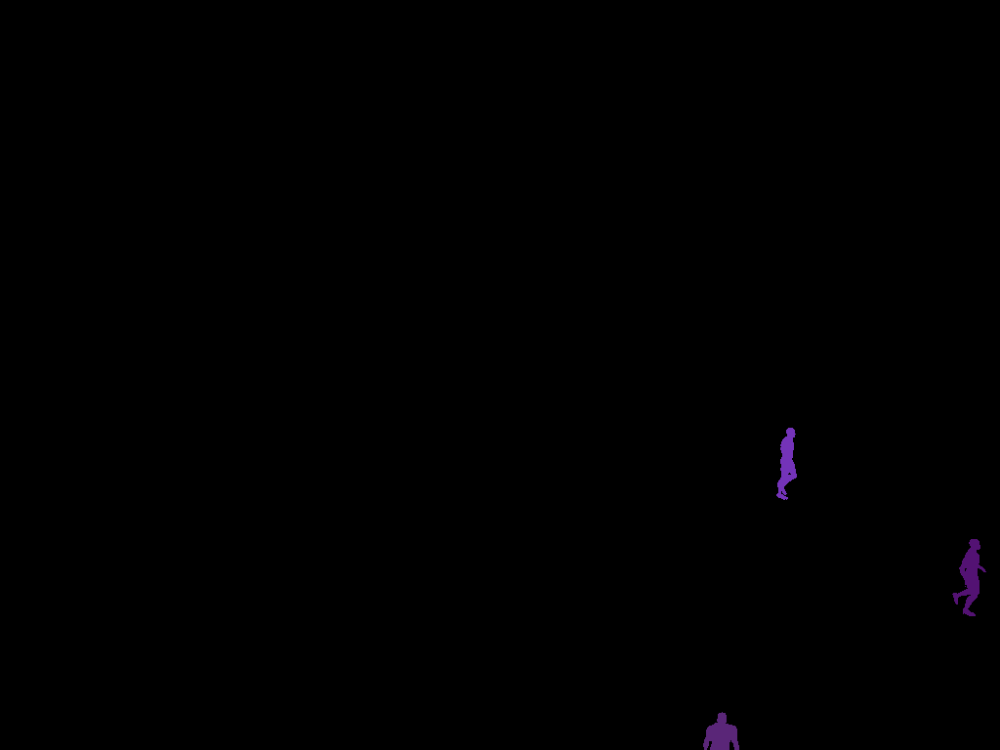

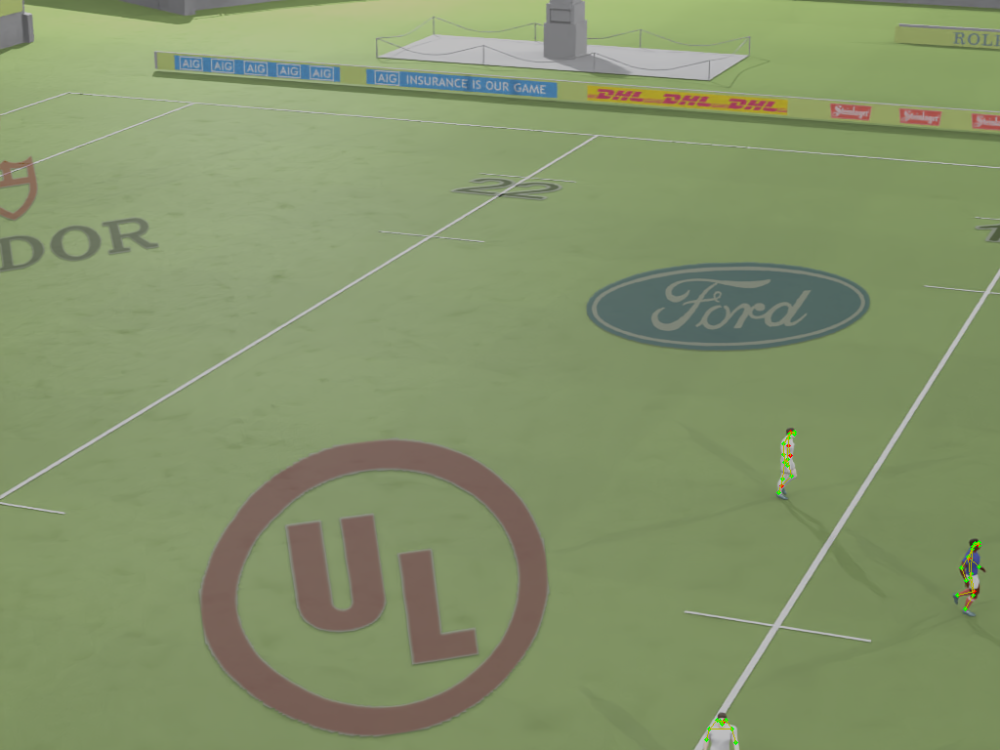

In [68]:
with example_assistant.get_visualizer() as visualizer:
    visualizer(renderer_ctx.render_to_numpy())

2021-11-01 11:24:04,943 | skyrenderer.utils.time_measurement |  INFO: Render time: 2.05 seconds


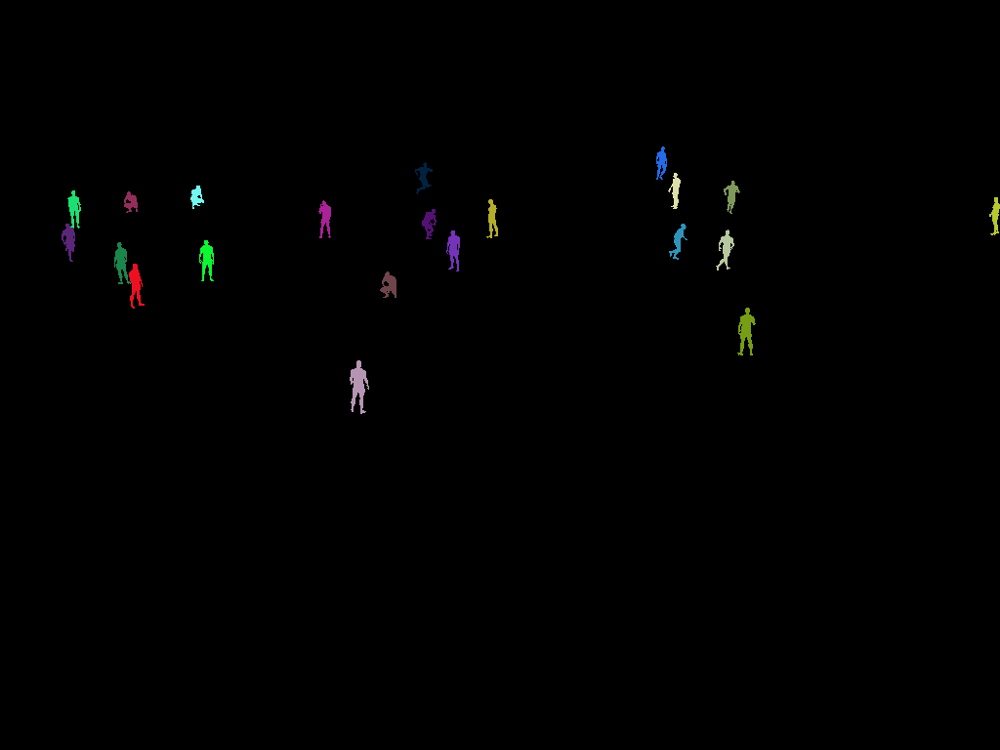

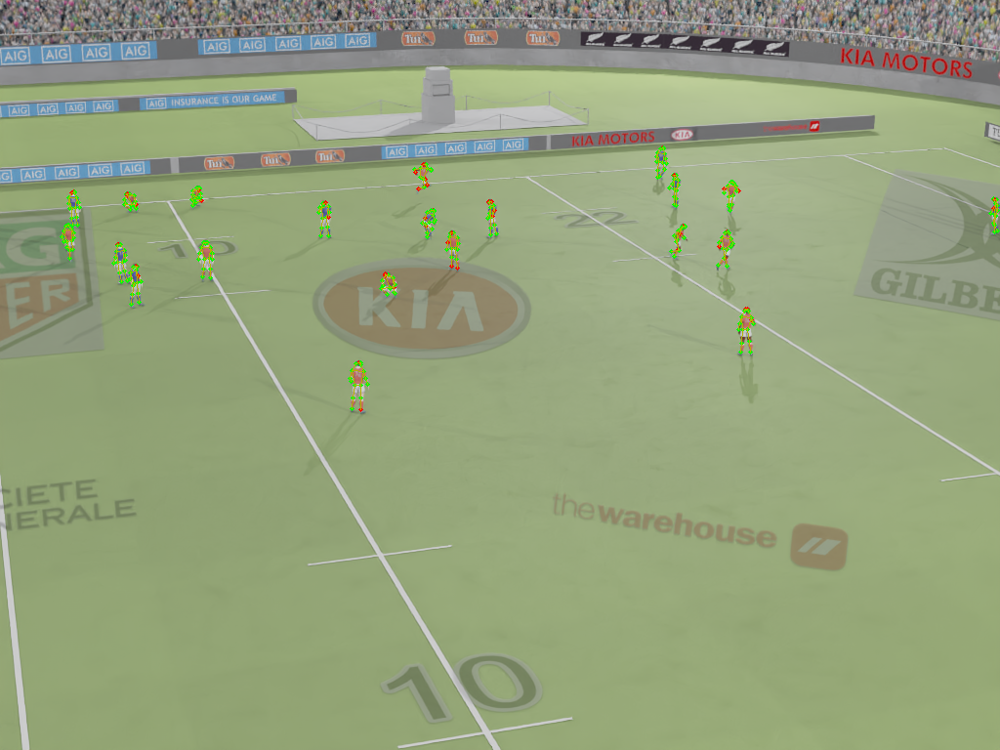

In [69]:
with example_assistant.get_visualizer() as visualizer:
    visualizer(renderer_ctx.render_to_numpy())

2021-11-01 11:24:06,848 | skyrenderer.utils.time_measurement |  INFO: Render time: 1.66 seconds


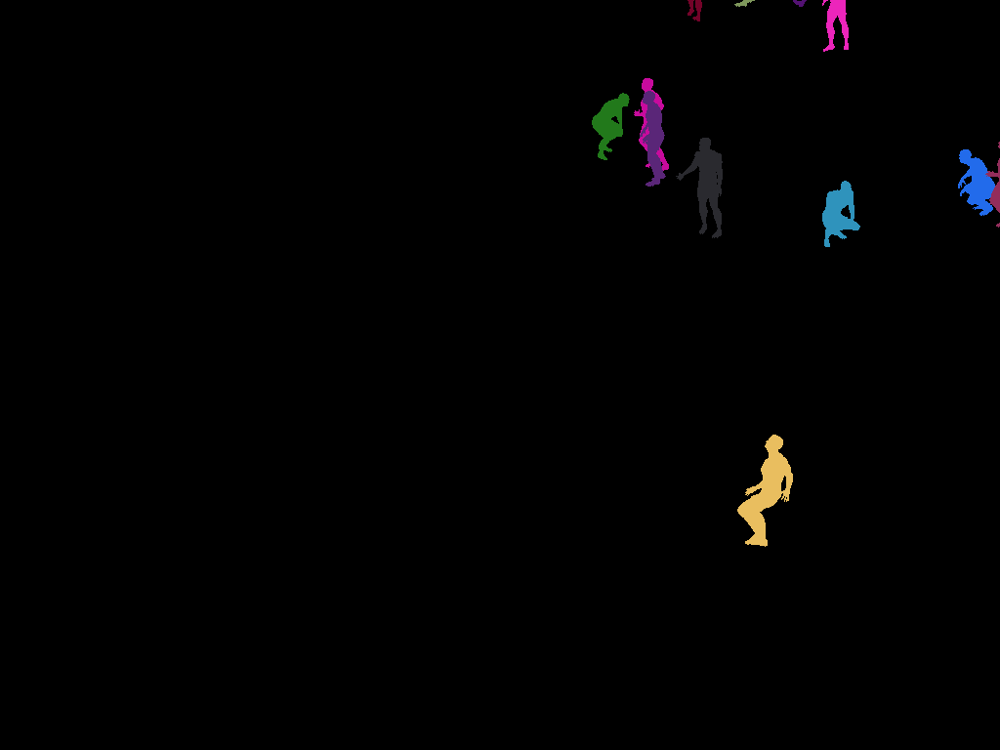

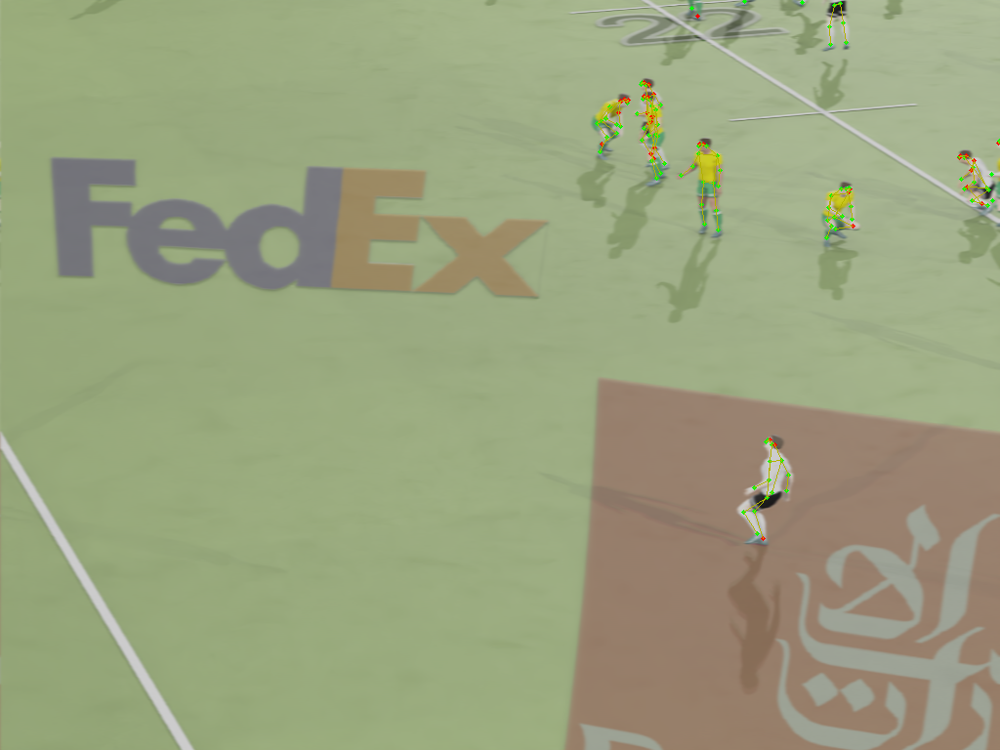

In [70]:
with example_assistant.get_visualizer() as visualizer:
    visualizer(renderer_ctx.render_to_numpy())

2021-11-01 11:24:08,622 | skyrenderer.utils.time_measurement |  INFO: Render time: 1.59 seconds


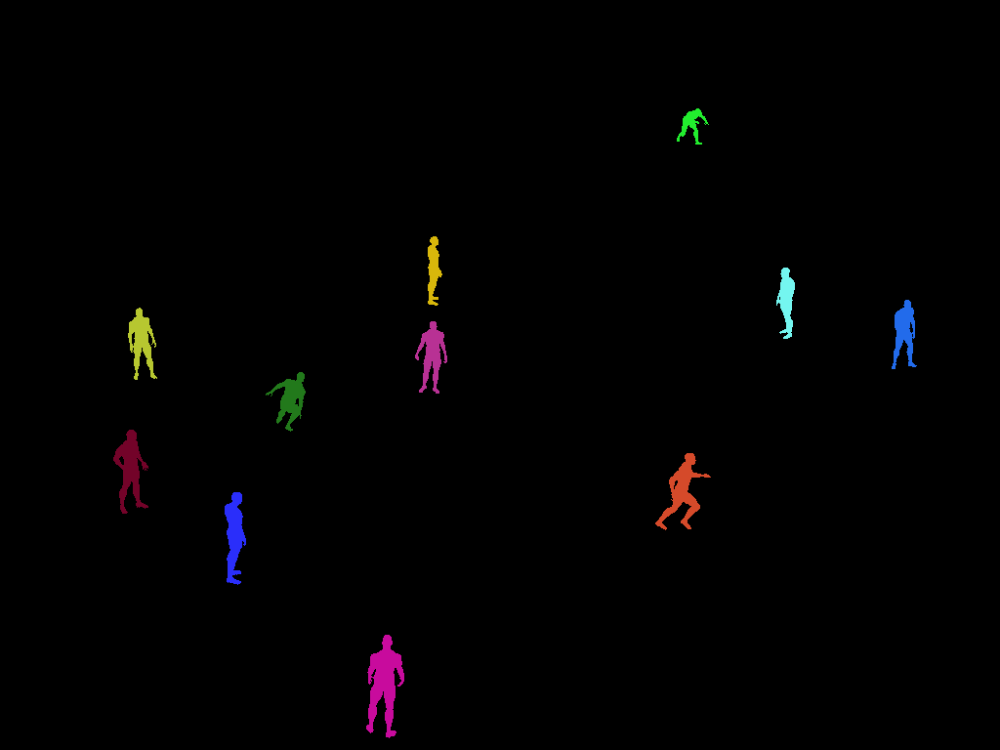

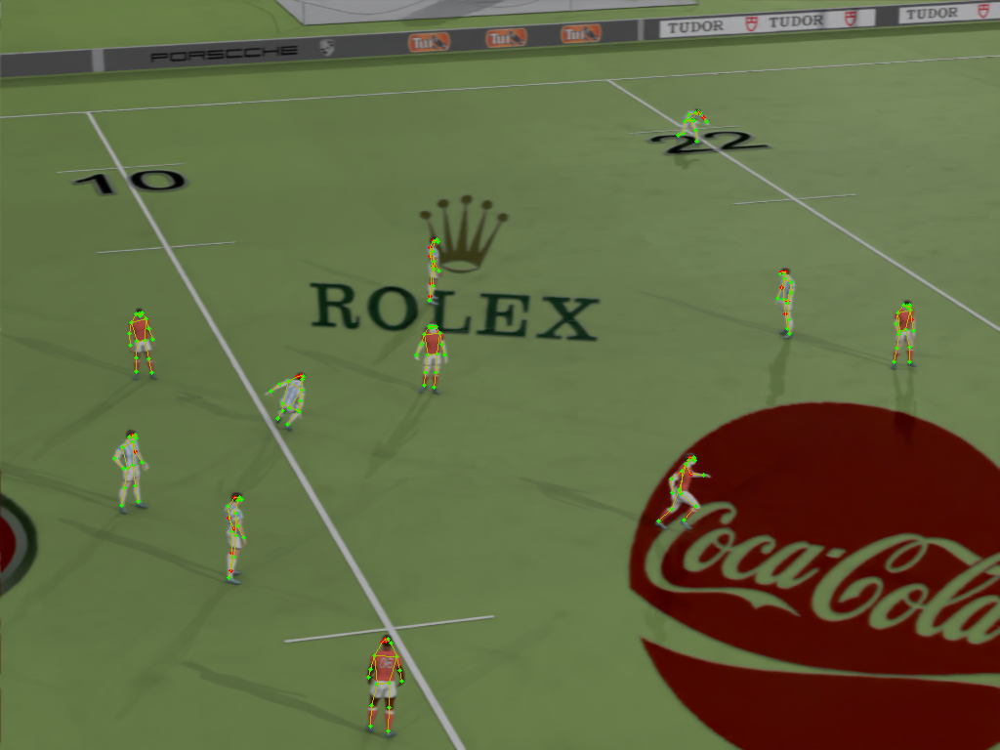

In [71]:
with example_assistant.get_visualizer() as visualizer:
    visualizer(renderer_ctx.render_to_numpy())

2021-11-01 11:24:11,482 | skyrenderer.utils.time_measurement |  INFO: Render time: 2.67 seconds


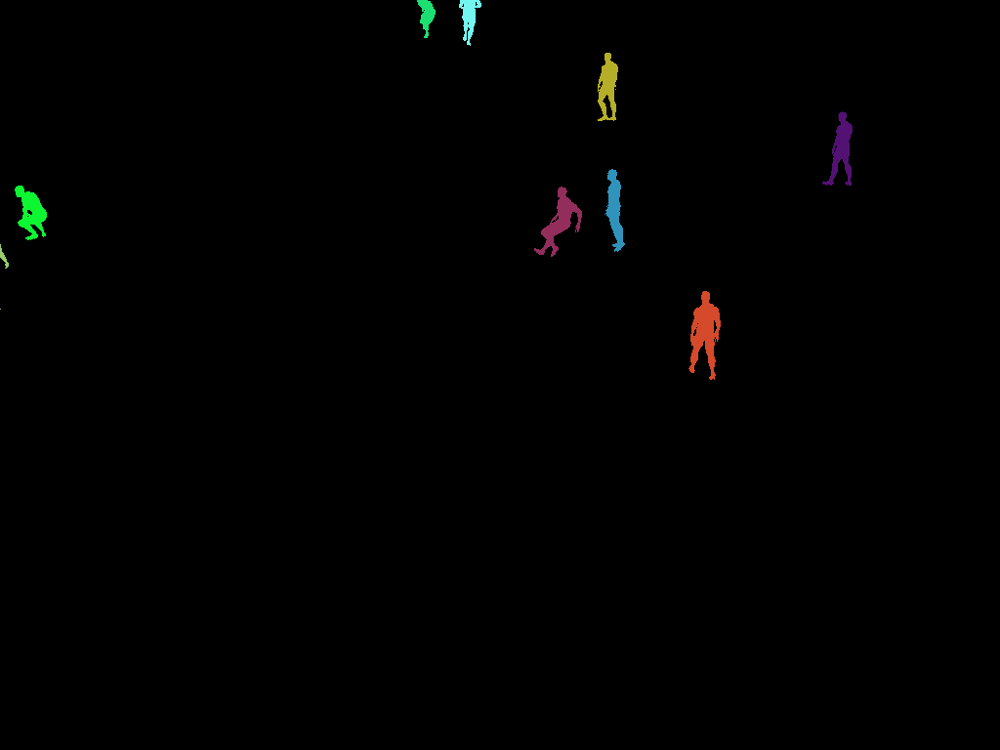

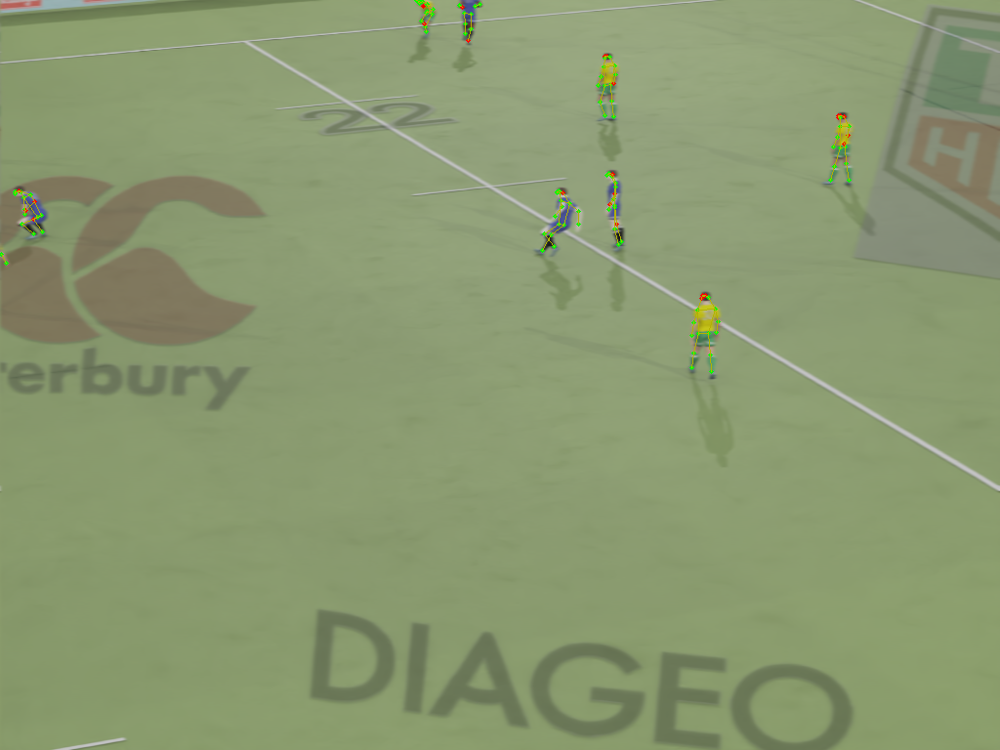

In [72]:
with example_assistant.get_visualizer() as visualizer:
    visualizer(renderer_ctx.render_to_numpy())

Everything is OK, so we can create a renderer datasource for training.

In [73]:
from skyengine.datasources.generic_renderer_data_source import GenericRendererDataSource

In [74]:
datasource = GenericRendererDataSource(
    renderer_context=renderer_ctx, images_number=20, cache_folder_name='rugby_presentation_new',
    required_gts_keys=['labels', 'bin_masks', 'boxes', 'instance_keypoints'])

# Training

Training configuration.

In [75]:
from deepsky.evaluators.sample_savers import ImageBboxKeyPointSaver, EvalHook
from deepsky.models.pose3d import get_pose_3d_model
from deepsky.trainers.trainer import DefaultTrainer
from deepsky.serializers.simple import SimpleSerializer
from skyengine.datasources.wrappers.mpose3d_wrapper import SEPose3DDataWrapper
from torch.utils.data import DataLoader
import torchvision.transforms as standard_transforms

In [76]:
import numpy as np

In [77]:
class Constants:
    TRAIN_BATCH_SIZE = 2
    VALID_BATCH_SIZE = 2
    NUM_WORKERS = 0
    TRAIN_SHUFFLE = True
    VALID_SHUFFLE = False
    DROP_LAST = True
    EPOCHS = 2

In [78]:
transform = standard_transforms.Compose([standard_transforms.ToPILImage(),
                                         standard_transforms.ToTensor()])

In [79]:
main_datasource = SEPose3DDataWrapper(datasource, img_transform=transform)
# split the dataset in train and test set
torch.manual_seed(79)
indices = torch.randperm(len(main_datasource)).tolist()
dataset = torch.utils.data.Subset(main_datasource, indices[:int(len(indices) * 0.9)])
dataset_test = torch.utils.data.Subset(main_datasource, indices[int(len(indices) * 0.9):])

In [80]:
def collate_fn(batch):
    return tuple(zip(*batch))

In [81]:
train_data_loader = DataLoader(dataset,
                               batch_size=Constants.TRAIN_BATCH_SIZE,
                               num_workers=Constants.NUM_WORKERS,
                               drop_last=Constants.DROP_LAST,
                               shuffle=Constants.VALID_SHUFFLE,
                               collate_fn=collate_fn)

In [82]:
valid_data_loader = DataLoader(dataset_test,
                               batch_size=Constants.VALID_BATCH_SIZE,
                               num_workers=Constants.NUM_WORKERS,
                               drop_last=Constants.DROP_LAST,
                               shuffle=Constants.TRAIN_SHUFFLE,
                               collate_fn=collate_fn)

In [83]:
model = get_pose_3d_model(main_datasource.joint_num, backbone_pretrained=True)
model = model.cuda(0)
logger.info('Train length in batches {}'.format(len(train_data_loader)))
logger.info('Test length in batches {}'.format(len(valid_data_loader)))

2021-11-01 11:24:12,538 | main |  INFO: Train length in batches 9
2021-11-01 11:24:12,539 | main |  INFO: Test length in batches 1


In [84]:
def keypoint_saver_transform(x):
    return x

In [85]:
key_point_saver = ImageBboxKeyPointSaver(keypoint_saver_transform, labels=['person'], colors_per_class=None,
                                         use_labels=False, connections=main_datasource.CONNECTIONS)

In [86]:
evalbatch = {'keypoints_3D_image_saver': (key_point_saver, 1)}

In [87]:
def hook_func(evalhook, images_batch, predictions_batch, metas_batch):

    """ hook_func is the function which EvalHook instance will execute after method "update" call. You should
    define this function according to evalbatch input of evaluator inside Trainer """

    for img, preds, metas in zip(images_batch, predictions_batch, metas_batch):
        img = standard_transforms.ToPILImage()(img.cpu())
        evalhook.count()
        poses_coords = metas['poses_coords'].numpy()
        poses_coords[:, :, 2] = metas['poses_viz'].squeeze(2).numpy()
        keypoint_targets = {'boxes': metas['boxes'], 'keypoints': poses_coords, 'stamp': 'GTS'}

        pred_poses_coords = preds['pred_poses_coords'].cpu().numpy()
        pred_poses_coords[:, :, 2] = 1
        keypoint_preds = {'boxes': preds['boxes'].cpu(), 'keypoints': pred_poses_coords, 'stamp': 'PREDS'}
        keypoint_name = 'img{}.png'.format(evalhook.counter)
        keypoints_image_saver_object, freq = evalhook.keypoints_3D_image_saver
        keypoints_image_saver_object.update(
            img_name=keypoint_name, images=[img], preds=[keypoint_preds], gts=[keypoint_targets])

In [88]:
evaluator = EvalHook(evalbatch, hook_func)

In [89]:
logger.info(model)

2021-11-01 11:24:12,614 | main |  INFO: Pose3DModel(
  (_backbone): Sequential(
    (0): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
    (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
    (3): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
    (4): Sequential(
      (0): Bottleneck(
        (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
        (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
        (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
        (bn3): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (relu): ReLU(inplace=True)
        (downs

In [90]:
optimizer = torch.optim.Adam(model.parameters(), lr=0.0001)
scheduler = torch.optim.lr_scheduler.MultiStepLR(optimizer, milestones=[16, 64], gamma=0.5)

In [91]:
serializer = SimpleSerializer(
    train_dir='pose3D_tests', ckpt_dir='checkpoints')

In [92]:
trainer = DefaultTrainer(
    data_loader=train_data_loader, model=model, epochs=Constants.EPOCHS, save_freq=1,
    valid_data_loader=valid_data_loader, optimizer=optimizer, evaluator=evaluator, scheduler=scheduler,
    serializer=serializer)

2021-11-01 11:24:12,676 | deepsky.serializers.simple |  INFO: Checkpoint was not provided, start from epoch 1
2021-11-01 11:24:12,677 | deepsky.trainers.generic |  INFO: Scheduler step will be applied per epoch


You've probably noticed that we set a tiny dataset: just 20 images.
Normally it would naturally be at least a few thousands of images,
but we can't wait now a few hours for the training to finish and we want to present the full Sky Engine workflow.

In [93]:
trainer.train()

[inf]: 100%|██████████| 1/1 [00:00<00:00,  2.95it/s]


2021-11-01 11:24:20,291 | deepsky.trainers.generic |  INFO: {'epoch': 1, 'train_loss': 7.31462377972073, 'val_loss': 7.0862345695495605}
2021-11-01 11:24:24,938 | deepsky.serializers.simple |  INFO: Saving checkpoint checkpoints/pose3D_tests/ckpt_epoch_1.pth.tar


[inf]: 100%|██████████| 1/1 [00:00<00:00,  2.49it/s]


2021-11-01 11:24:31,531 | deepsky.trainers.generic |  INFO: {'epoch': 2, 'train_loss': 6.829195605383979, 'val_loss': 6.547126293182373}
2021-11-01 11:24:36,123 | deepsky.serializers.simple |  INFO: Saving checkpoint checkpoints/pose3D_tests/ckpt_epoch_2.pth.tar


After each epoch we save a checkpoint and produce some inference example on inference data
to be able to see the training progress.
Images generated during longer training process as above on bigger datasets are presented as follows:

In [94]:
show_jupyter_picture('gtc03_assets/trained/img1.png')

![](gtc03_assets/trained/img1.png)

In [95]:
show_jupyter_picture('gtc03_assets/trained/img2.png')

![](gtc03_assets/trained/img2.png)

## On real data

The trained model ran on real images gives the result like this. **Note, that all the training data was synthetic,
i.e. the model never saw the real, labeled images during training.
All its knowledge comes from the rendered images.**

In [96]:
show_jupyter_movie('gtc03_assets/trained/keypoints.mp4')

<video style="width: 100%" src="gtc03_assets/trained/keypoints.mp4" type="video/mp4" controls playsinline />

Lets load model for 3D pose estimation pretrained on large synthetic data and run inference on real rugby match.

In [97]:
device = torch.device('cuda')

In [98]:
resume_path = 'gtc03_assets/trained/pose3d.pth.tar'
checkpoint = torch.load(resume_path)
model_weights = checkpoint['state_dict']
model.load_state_dict(model_weights)
model = model.to(device)

We will need also player detection model which also was trained on the same artificial data with bouding
boxes provided by the same renderer datasource.

In [99]:
from deepsky.models.maskrcnn import get_model_from_coco_pretrained
from deepsky.datasources.image_inference import ImageInferenceDatasource
from human_pose_estimation_helpers import bboxes_viz, plot_pose3D, make_patch, _image_to_3dbox_world, \
    _bboxes_to_low_corner
from PIL import Image

In [100]:
detection_model = get_model_from_coco_pretrained(num_classes=3,
                                                 anchor_sizes=((16,), (32,), (48,), (64,), (72,)),
                                                 ratios=((0.5, 0.75, 1.0),),
                                                 pretrained=False)

In [101]:
checkpoint = torch.load('gtc03_assets/trained/rugby_detection.pth.tar')
for k, v in sorted(checkpoint.items()):
    checkpoint[''.join(['_model.', k])] = checkpoint.pop(k)
detection_model.load_state_dict(checkpoint)
detection_model = detection_model.to(device)
real_dataset = ImageInferenceDatasource(dir='gtc03_assets/real_data', extension='png')

Lets detect players and vizualize results

In [102]:
img, file_path = real_dataset[75]
orig_img = Image.open(file_path)
detection_model.eval()
with torch.no_grad():
    img = img.to(device)
    outputs = detection_model(img.unsqueeze(0))
out = outputs.pop()
bboxes = out['boxes'].cpu().detach().numpy()
labels = out['labels'].cpu().detach().numpy()
bboxes = bboxes[np.where(labels == 1)[0]]

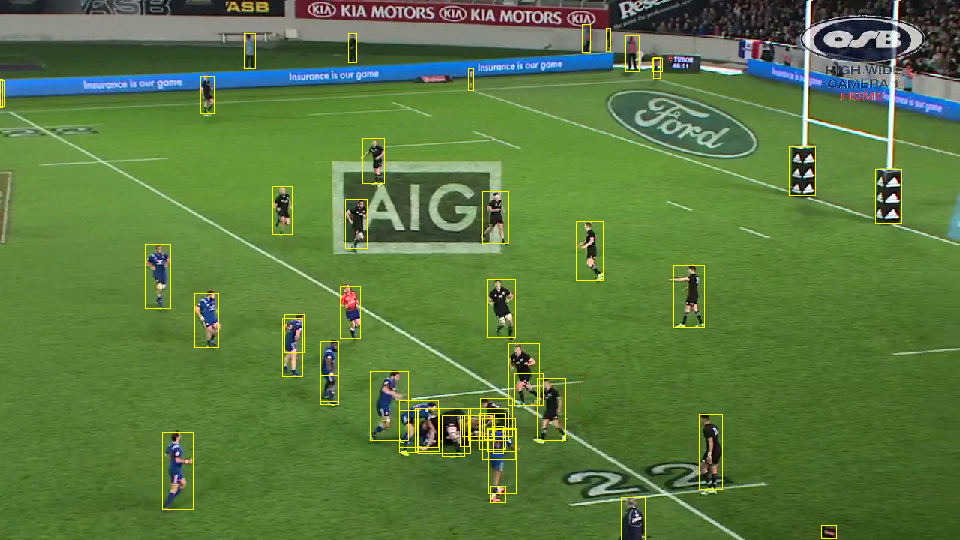

In [103]:
bbox_image = bboxes_viz(orig_img, bboxes)
bbox_image

After bounding boxes were generated, we can crop target objects and estimate the pose in 3D space.
for data preprocessing we will use the same datasource we have used during training

In [104]:
model.eval()
with torch.no_grad():
    results = model((img,), ({'boxes': torch.from_numpy(bboxes).int()},))
results = results.pop()
output_coords, output_bboxes = results['pred_poses_coords'].cpu(), \
                               results['boxes'].cpu()

In [105]:
output_coords[:2]

tensor([[[ 1.5799e+02,  2.4906e+02, -3.3868e+02],
         [ 1.5896e+02,  2.4749e+02, -3.2971e+02],
         [ 1.5684e+02,  2.4739e+02, -3.6277e+02],
         [ 1.5952e+02,  2.4755e+02, -2.3072e+02],
         [ 1.5446e+02,  2.4733e+02, -3.1714e+02],
         [ 1.6213e+02,  2.5346e+02, -2.7913e+01],
         [ 1.5010e+02,  2.5505e+02, -1.8152e+02],
         [ 1.6677e+02,  2.6024e+02,  1.1821e+02],
         [ 1.4531e+02,  2.6259e+02, -6.6026e+01],
         [ 1.6512e+02,  2.6085e+02, -2.0557e+02],
         [ 1.4812e+02,  2.6420e+02, -3.1455e+02],
         [ 1.6190e+02,  2.7263e+02,  4.4355e+01],
         [ 1.5566e+02,  2.7387e+02, -5.2210e+01],
         [ 1.6229e+02,  2.8619e+02,  2.7500e+02],
         [ 1.5843e+02,  2.8997e+02, -2.0544e+02],
         [ 1.5722e+02,  2.9506e+02,  4.2335e+02],
         [ 1.5921e+02,  3.0535e+02, -2.1471e+02],
         [ 1.5870e+02,  2.7340e+02, -1.6177e-01]],

        [[ 5.8450e+02,  2.2376e+02, -2.5479e+02],
         [ 5.8542e+02,  2.2238e+02, -2.7756e+02]

In [106]:
n = 6

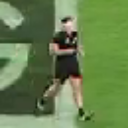

In [107]:
boxes = _bboxes_to_low_corner(output_bboxes)
crops = make_patch(img, boxes.int())
pil_img = standard_transforms.ToPILImage()(crops[n].squeeze(0).cpu())
pil_img

In [108]:
coord = _image_to_3dbox_world(output_coords, boxes, 2000)

<IPython.core.display.Javascript object>


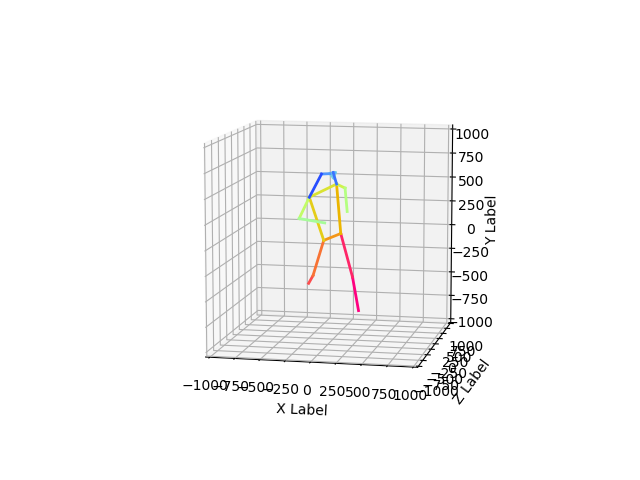

In [109]:
from mpl_toolkits.mplot3d import Axes3D
%matplotlib notebook
plot_pose3D(kpt_3d=np.expand_dims(coord[n], 0), kps_lines=main_datasource.CONNECTIONS)